## Importing, Cleaning and Processing

This process is detailed in CA4023-Part-2.ipynb

In [1]:
import pandas as pd
import string

df = pd.read_table('../data/etymwn.tsv', header=None)

df2 = df.loc[df[0].str[:3] == 'eng']

df3 = df2.loc[df2[1].str[4:] == 'etymology']

df4 = df3.loc[df3[2].str[:3] != 'eng']

df4[2] = df4[2].str[:3]

df4[0] = df4[0].str[4:]

df4 = df4.drop(1, axis=1)

lanAlt = pd.read_csv('../data/iso-639-3_Name_Index_20230123.tab', sep='\t')

lang_dict = dict(zip(lanAlt['Id'], lanAlt['Print_Name']))
lang_dict['p_s'] = 'unknown'
lang_dict['nah'] = 'Nahuatl'
lang_dict['nan'] = 'Min Nan'
lang_dict['wit'] = 'unknown'

for i, v in df4.iterrows():
    df4[2][i] = lang_dict[v[2]]
    v[0] = v[0].replace('-', '')
    v[0] = v[0].replace("'", "")

df4[2] = df4[2].str.replace(r'\(.*\)', '', regex=True)

language_counts = df4[2].value_counts()
result_df = pd.DataFrame({'Language': language_counts.index, 'Count': language_counts.values})
topLang = result_df['Language'].tolist()[:10]

drop_in = []

for i, v in df4.iterrows():
  if v[2] not in topLang:
    drop_in.append(i)

for i in drop_in:
  df4.drop(i, inplace=True)

C:\Users\stang\AppData\Local\Temp\ipykernel_3096\1251143065.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df4[2] = df4[2].str[:3]
C:\Users\stang\AppData\Local\Temp\ipykernel_3096\1251143065.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df4[0] = df4[0].str[4:]
C:\Users\stang\AppData\Local\Temp\ipykernel_3096\1251143065.py:27: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but w

## Merging Languages

Like discussed in part 2, I will merge "French", "Middle French" and "Old French" as they are too similar to tell apart and I will merge "Middle English" and "Old English" for the same reason. These will be refered too as "French" and "English" respectivley from now on but keep in mind that "English" refers to Old and Middle English and not "Modern English". This leaves us with seven classes.

In [2]:
#Giving the dataset a more interperetable name
lang_data = df4

In [3]:
for i, v in lang_data.iterrows():
  if "English" in v[2]:
    lang_data[2][i] = "English"
  elif "French" in v[2]:
    lang_data[2][i] = "French"

C:\Users\stang\AppData\Local\Temp\ipykernel_3096\3870545309.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  lang_data[2][i] = "English"
C:\Users\stang\AppData\Local\Temp\ipykernel_3096\3870545309.py:5: FutureWarning: ChainedAssignmentErr

In [4]:
print("Languages we are left with:")

for i in lang_data[2].unique().tolist():
  print(i)

Languages we are left with:
Latin
English
French
Ancient Greek 
Spanish
Japanese
Italian


## Supervised Machine Learning

We will fist attempt to solve this problem using multinomial Naive Bayes and Logistic Regression. We will the look at an SVM model before finally moving onto a LSTM model.

In [5]:
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn import metrics
from sklearn.metrics import confusion_matrix, classification_report


# Step 1: Vectorize the text data
vectorizer = TfidfVectorizer(analyzer='char', ngram_range=(2,3))
X = vectorizer.fit_transform(lang_data[0])
y = lang_data[2]

# Step 2: Split the data into training and testing sets
# We use the same random state to get an result that we can compare to our baseline from Part 2
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 3: Train a Naive Bayes model
classifier = MultinomialNB()
classifier.fit(X_train, y_train)

# Step 4: Evaluate the model
y_pred = classifier.predict(X_test)

# Print metrics
print("Accuracy:", metrics.accuracy_score(y_test, y_pred))
print("Precision:", metrics.precision_score(y_test, y_pred, average='weighted'))
print("Recall:", metrics.recall_score(y_test, y_pred, average='weighted'))
print("F1 Score:", metrics.f1_score(y_test, y_pred, average='weighted'))

Accuracy: 0.625829504849413
Precision: 0.6097203883230191
Recall: 0.625829504849413
F1 Score: 0.5956737131896774


c:\Users\stang\miniconda3\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [6]:
from sklearn.linear_model import LogisticRegression

# Initialize the model
logistic_regression_model = LogisticRegression(multi_class='multinomial', solver='lbfgs', max_iter=250)

# Train the model
logistic_regression_model.fit(X_train, y_train)

# Evaluate the model
y_pred = logistic_regression_model.predict(X_test)

# Print metrics
print("Accuracy:", metrics.accuracy_score(y_test, y_pred))
print("Precision:", metrics.precision_score(y_test, y_pred, average='weighted'))
print("Recall:", metrics.recall_score(y_test, y_pred, average='weighted'))
print("F1 Score:", metrics.f1_score(y_test, y_pred, average='weighted'))

Accuracy: 0.664624808575804
Precision: 0.6655885869618402
Recall: 0.664624808575804
F1 Score: 0.6487961233745566


In [7]:
from sklearn.svm import LinearSVC

# Initialize the model
svm_model = LinearSVC(multi_class='ovr')

# Train the model
svm_model.fit(X_train, y_train)

y_pred = svm_model.predict(X_test)

# Print metrics
print("Accuracy:", metrics.accuracy_score(y_test, y_pred))
print("Precision:", metrics.precision_score(y_test, y_pred, average='weighted'))
print("Recall:", metrics.recall_score(y_test, y_pred, average='weighted'))
print("F1 Score:", metrics.f1_score(y_test, y_pred, average='weighted'))

Accuracy: 0.6717713118938233


c:\Users\stang\miniconda3\Lib\site-packages\sklearn\svm\_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


Precision: 0.6661210802172769
Recall: 0.6717713118938233
F1 Score: 0.6642482697210079


We are testing our best supervised model against our random 30 sample

In [8]:
def classify_text(text):
    # Transform the text using the same vectorizer
    X_text = vectorizer.transform([text])

    # Predict the language using the trained model
    predicted_language = svm_model.predict(X_text)[0]

    return predicted_language

In [9]:
test = pd.read_csv('../data/test.csv')

In [10]:
correct = []
all = []

for i, r in test.iterrows():
  if classify_text(r['0']) == r['2']:
    correct.append(1)
  all.append(1)

accuracy = sum(correct)/sum(all)
print(accuracy)

0.7333333333333333


The SVM model seems to perform best out of these three models but not by much. I will now build an ensemble model based on these three models to attempt to imporve the accuracy

In [11]:
import numpy as np

In [12]:
def ensemble_model(X_test):
  y_pred = []
  for i in X_test:
    if svm_model.predict(i) == classifier.predict(i) or svm_model.predict(i) == logistic_regression_model.predict(i):
      y_pred.append(svm_model.predict(i))
    elif classifier.predict(i) == logistic_regression_model.predict(i):
      y_pred.append(classifier.predict(i))
    else:
      y_pred.append(svm_model.predict(i))
  return np.array(y_pred)

In [13]:
y_pred = ensemble_model(X_test)

print("Accuracy:", metrics.accuracy_score(y_test, y_pred))
print("Precision:", metrics.precision_score(y_test, y_pred, average='weighted'))
print("Recall:", metrics.recall_score(y_test, y_pred, average='weighted'))
print("F1 Score:", metrics.f1_score(y_test, y_pred, average='weighted'))

Accuracy: 0.6715160796324655
Precision: 0.6680727389704221
Recall: 0.6715160796324655
F1 Score: 0.6570467776613144


## LSTM

In this section I train an LSTM model to predict the etymology of a english word

I had also ran a Simple RNN and a CNN but neither yielded better results than the LSTM.

In [14]:
import tensorflow as tf
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, Bidirectional, LSTM, Dense, SimpleRNN, Conv1D, GlobalMaxPooling1D
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences

In [15]:
#I tell the tokenizer to look at the character sequences as oppose to the word on its own
max_sequence_length = 10
tokenizer = Tokenizer(char_level=True, analyzer='char')
tokenizer.fit_on_texts(lang_data[0])
X = tokenizer.texts_to_sequences(lang_data[0])
X = pad_sequences(X, maxlen=max_sequence_length, padding='post')

In [16]:
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(lang_data[2])

In [17]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [18]:
model = Sequential()
model.add(Embedding(input_dim=len(tokenizer.word_index) + 1, output_dim=100, input_length=X.shape[1]))
model.add((LSTM(250)))
model.add(Dense(12, activation='softmax'))

c:\Users\stang\miniconda3\Lib\site-packages\keras\src\layers\core\embedding.py:90: UserWarning: Argument `input_length` is deprecated. Just remove it.
  warnings.warn(


In [19]:
model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

In [20]:
print(model.summary())

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding (Embedding)           │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm (LSTM)                     │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ ?                      │   0 (unbuilt) │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 0 (0.00 B)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 0 (0.00 B)

None


In [21]:
model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=10, batch_size=64)

Epoch 1/10
245/245 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.4616 - loss: 1.5214 - val_accuracy: 0.5490 - val_loss: 1.2164
Epoch 2/10
245/245 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - accuracy: 0.5345 - loss: 1.2100 - val_accuracy: 0.5587 - val_loss: 1.1329
Epoch 3/10
245/245 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - accuracy: 0.5689 - loss: 1.1251 - val_accuracy: 0.5794 - val_loss: 1.0630
Epoch 4/10
245/245 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - accuracy: 0.5822 - loss: 1.0654 - val_accuracy: 0.5911 - val_loss: 1.0261
Epoch 5/10
245/245 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - accuracy: 0.6100 - loss: 0.9972 - val_accuracy: 0.6044 - val_loss: 0.9864
Epoch 6/10
245/245 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - accuracy: 0.6186 - loss: 0.9698 - val_accuracy: 0.6210 - val_loss: 0.9593
Epoch 7/10
245/245 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - accuracy: 0.6391 - loss: 0.9245 - val_accuracy: 0.6279 - val_loss: 0.9351
Epoch 8/10
245/245 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step - accuracy: 0.6466 - loss: 0.9032 - val_accu

In [22]:
accuracy = model.evaluate(X_test, y_test)[1]
print(f"Test Accuracy: {accuracy * 100:.2f}%")

123/123 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6605 - loss: 0.8746
Test Accuracy: 65.70%


## Best Model

After attempting several models I concluded that teh SVM model performed the best. I decided to investigate further into this model to see where it was going wrong.

In [23]:
vectorizer = TfidfVectorizer(analyzer='char', ngram_range=(2,3))
X = vectorizer.fit_transform(lang_data[0])
y = lang_data[2]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

svm_model = LinearSVC(multi_class='ovr')

svm_model.fit(X_train, y_train)

y_pred = svm_model.predict(X_test)

print("Accuracy:", metrics.accuracy_score(y_test, y_pred))
print("Precision:", metrics.precision_score(y_test, y_pred, average='weighted'))
print("Recall:", metrics.recall_score(y_test, y_pred, average='weighted'))
print("F1 Score:", metrics.f1_score(y_test, y_pred, average='weighted'))

Accuracy: 0.6717713118938233
Precision: 0.6661210802172769
Recall: 0.6717713118938233
F1 Score: 0.6642482697210079


c:\Users\stang\miniconda3\Lib\site-packages\sklearn\svm\_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(



Confusion Matrix:
[[ 189   25   31    1    4   88    1]
 [   9  891  131    0    3   83    1]
 [  32  167  419    1    0  259    5]
 [   2    7   28   24    0   26    5]
 [   2    8    5    0   67    1    0]
 [  78   62  156    6    5 1022    3]
 [   5    7   17    2    0   20   20]]


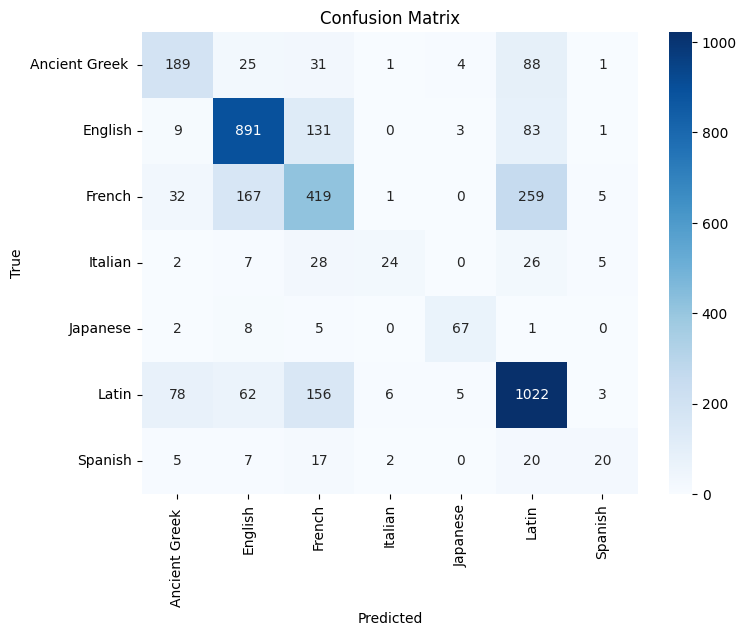

In [24]:
import seaborn as sns
import matplotlib.pyplot as plt

# Calculate confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

# Print confusion matrix
print("\nConfusion Matrix:")
print(conf_matrix)

# Visualize confusion matrix using seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(y), yticklabels=np.unique(y))
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

It seems that French and Latin in particular are getting mixed up by the model. This is probably due to that fact French and Latin are similar languages as well as that fact that Latin is a dominant class in this data and the model is probably skewed towards is

I decided to take French out of the data to see if it would significantly improve the results

In [25]:
no_french_data = lang_data

In [26]:
for i, v in no_french_data.iterrows():
  if "English" in v[2]:
    v[2] = "English"
  elif "French" in v[2]:
    no_french_data.drop(i, inplace=True)

In [27]:
no_french_data[2].unique()

array(['Latin', 'English', 'Ancient Greek ', 'Spanish', 'Japanese',
       'Italian'], dtype=object)

In [28]:
vectorizer = TfidfVectorizer(analyzer='char', ngram_range=(2,3))
X = vectorizer.fit_transform(no_french_data[0])
y = no_french_data[2]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

svm_model = LinearSVC(multi_class='ovr')

svm_model.fit(X_train, y_train)

y_pred = svm_model.predict(X_test)

print("Accuracy:", metrics.accuracy_score(y_test, y_pred))
print("Precision:", metrics.precision_score(y_test, y_pred, average='weighted'))
print("Recall:", metrics.recall_score(y_test, y_pred, average='weighted'))
print("F1 Score:", metrics.f1_score(y_test, y_pred, average='weighted'))

Accuracy: 0.802048909451421
Precision: 0.7976050448565981
Recall: 0.802048909451421
F1 Score: 0.7950851038074165


c:\Users\stang\miniconda3\Lib\site-packages\sklearn\svm\_classes.py:31: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(



Confusion Matrix:
[[ 202   40    1    2  101    0]
 [   9  980    1    2  116    4]
 [   1    9   27    3   36    4]
 [   0   12    1   58    4    1]
 [  96   98    1    2 1139    3]
 [   4   13    3    1   31   21]]


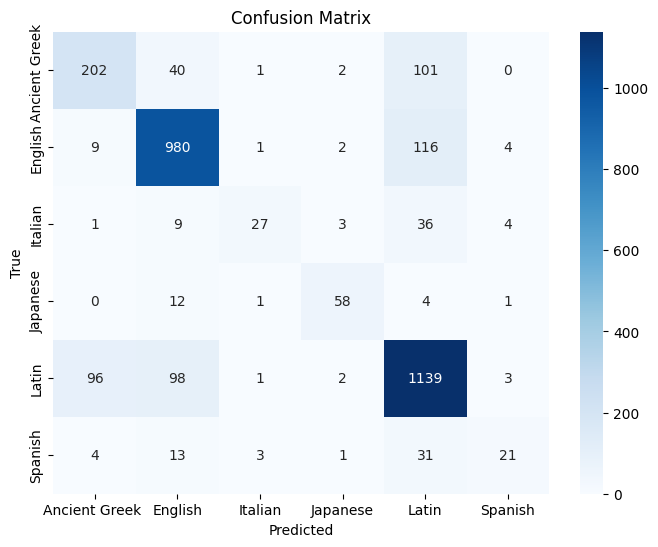

In [29]:
# Calculate confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

# Print confusion matrix
print("\nConfusion Matrix:")
print(conf_matrix)

# Visualize confusion matrix using seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(y), yticklabels=np.unique(y))
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

As you can see this massively improved the accuracy. However, I beleived that this was bad practice given the fact that som many english words have their etymological roots in either "French", "Middle French" or "Old French". I included the results as an interesting thing to meantion but I will not be moving forward with that approach.